In [1]:
import librosa, librosa.display, scipy, math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import IPython.display as ipd
from sklearn.preprocessing import minmax_scale
from scipy.signal import find_peaks, argrelmin
from scipy.fftpack import fft, fftfreq

---

### <i>"Clearly the timbre of an instrument strongly affects what tuning and scale sound best on that instrument."</i> 

#### — Wendy Carlos

---

# Deriving a scale (and tuning) from the timbre of a sound

#### This notebook uses the sound of a physically modeled double-plate system** and derives a musical scale (and/or tuning scheme) using the concept of "dissonance curves" as described in the book <i> Tuning, Timbre, Spectrum, Scale</i> by William A. Sethares.  This "spectrum-scale" is then used to tune a larger system of multiple double-plate instruments where each plate is tuned to an interval found at the minima of the source sound's dissonance curve.

** a simulation of two suspended circular metal plates connected connected by a rod, struck with a metal mallet, and with microphone pickups placed above and below modeled with the <i>Modalys</i> physically modeling library and synthesis engine for Max/MSP.

#### To outline the complete process:

### (1) Choose a sound
### (2) Find the spectrum of the sound
### (3) Simplify the spectrum
### (4) Draw the dissonance curve / select scale intervals
### (5) Create an instrument
### (6) Play music

---

<h1> (1) CHOOSE A SOUND

#### We will be using a single percussive hit from a physically modeled double-plate system as our source sound:

In [2]:
sound_file = 'Audio/hh_1.wav'

In [3]:
sound_waveform, sample_rate = librosa.load(sound_file)

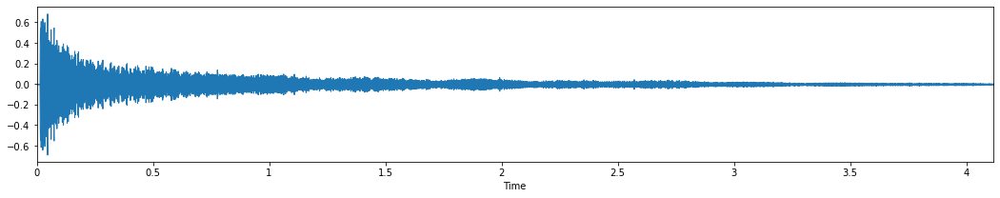

In [4]:
plt.figure(figsize=(18,3))
librosa.display.waveplot(sound_waveform, sr=sample_rate)

In [5]:
ipd.Audio(sound_file)

---

<h1> (2) FIND THE SPECTRUM OF THE SOUND

In [6]:
def plot_spectrum(freqs, mags, peak_freqs, peak_mags, spec_range=(), peak_labels=True):
    fig = plt.figure(figsize=(18, 5))
    ax = fig.subplots()
    ax.plot(freqs, mags)
    if peak_labels:
        ax.scatter(peak_freqs, peak_mags, color='r', s=50, marker='D', label='Peaks')    
        peak_labels = [str(round(peak, 2)) + 'Hz' for peak in peak_freqs]
        plt.xticks(peak_freqs, peak_labels, fontsize=14, rotation='vertical')
        ax.legend()
    else:
        plt.xticks(np.arange(spec_range[0],spec_range[1],1000), fontsize=14)       
        plt.xlabel('Frequency (Hz)', fontsize=18)
    
    plt.xlim([spec_range[0],spec_range[1]])
    plt.ylabel('Magnitude', fontsize=18)
    plt.show()

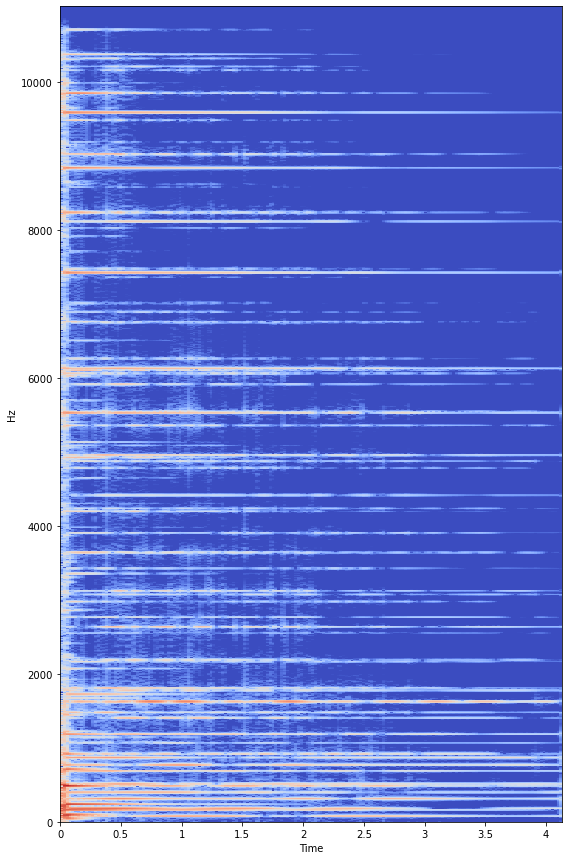

In [7]:
sound_stft = librosa.stft(sound_waveform)
sound_db = librosa.amplitude_to_db(abs(sound_stft))
plt.figure(figsize=(9, 15))
librosa.display.specshow(sound_db, sr=sample_rate, x_axis='time', y_axis='hz')

In [8]:
sound_fft = scipy.fft.fft(sound_waveform)
sound_mag = minmax_scale(np.absolute(sound_fft), axis=0)
frequencies = np.linspace(0, sample_rate, len(sound_mag)) # frequency variable

In [9]:
peaks = find_peaks(sound_mag, height=0.2, threshold=0.001, distance=5)
peak_mags = np.array([amp for amp in peaks[1]['peak_heights']])
peak_freqs = np.array(frequencies[peaks[0]])

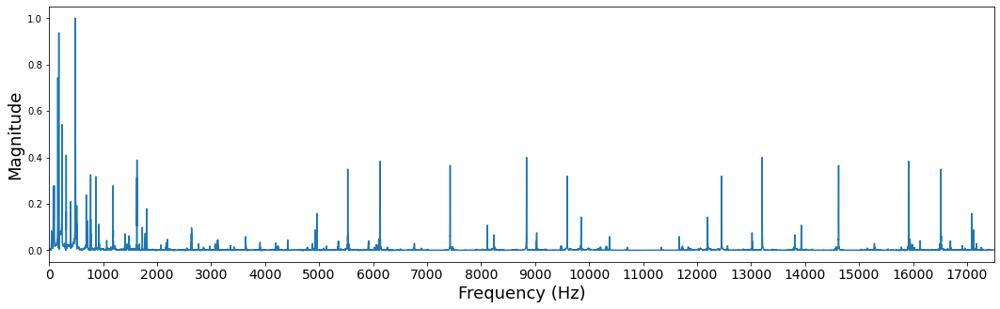

In [10]:
plot_spectrum(frequencies, sound_mag, peak_freqs, peak_mags, (0,17500), peak_labels=False)

#### This spectrum is very complex so we will focus our attention on four major areas of interest:

### 70Hz - 560Hz

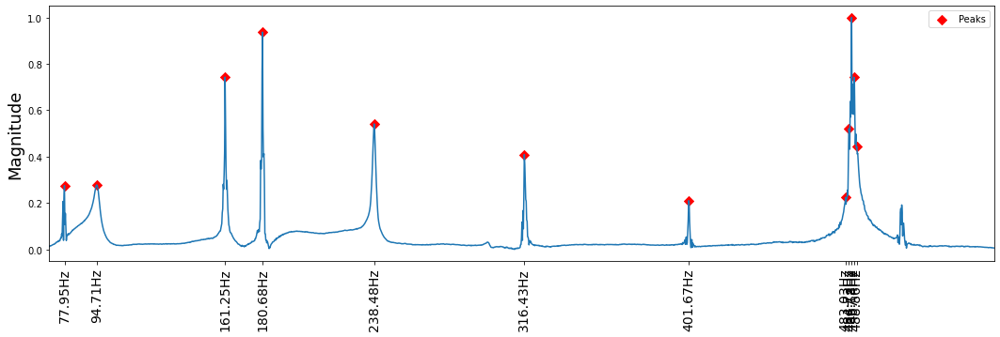

In [11]:
plot_spectrum(frequencies, sound_mag, peak_freqs, peak_mags, (70,560))

### 650Hz - 1,650Hz

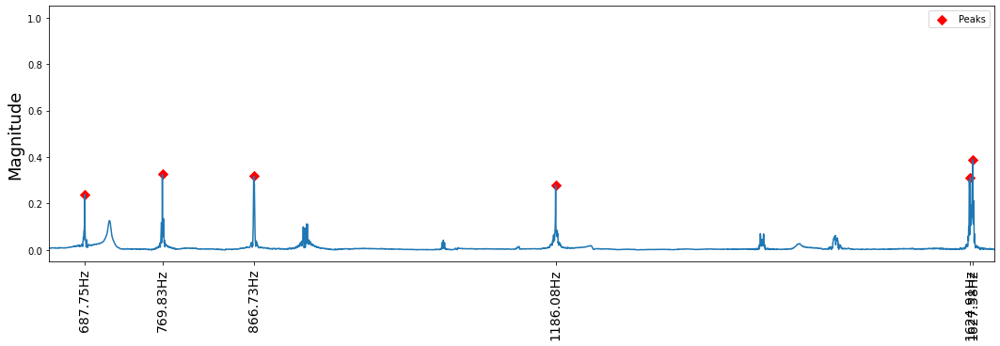

In [12]:
plot_spectrum(frequencies, sound_mag, peak_freqs, peak_mags, (650,1650))

### 5,000Hz - 10,000Hz

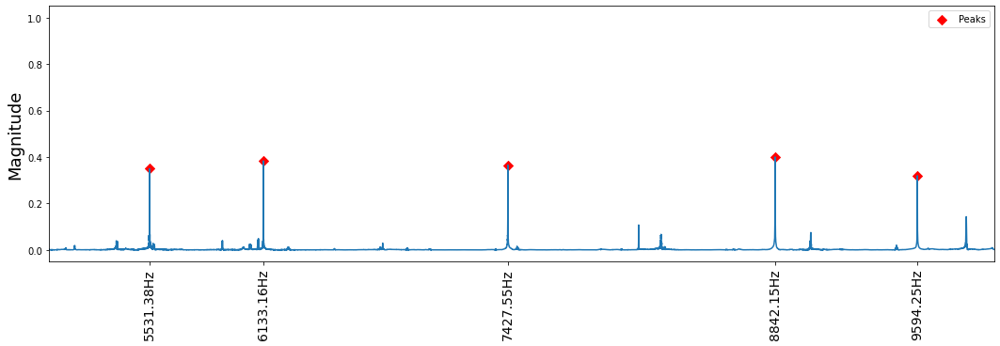

In [13]:
plot_spectrum(frequencies, sound_mag, peak_freqs, peak_mags, (5000,10000))

### 8,250Hz - 16,500Hz

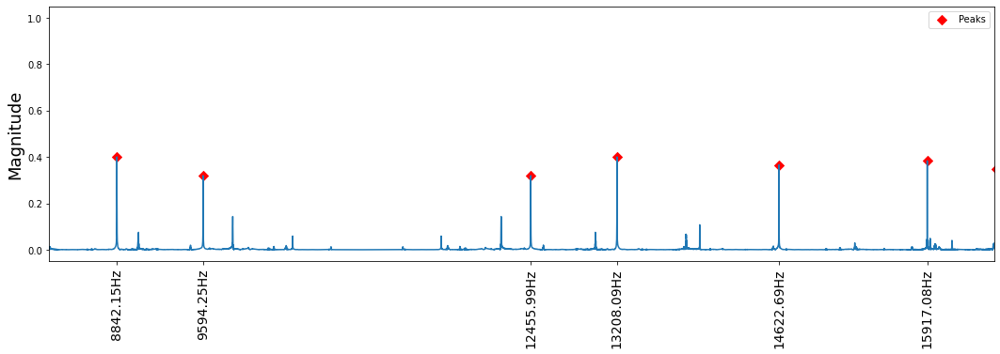

In [14]:
plot_spectrum(frequencies, sound_mag, peak_freqs, peak_mags, (8250,16500))

---

<h1> (3) SIMPLIFY THE SPECTRUM

### Select only the most significant peaks from the spectrum

In [15]:
def plot_peaks(peaks, mags, plot_range=(), width=10):
    fig = plt.figure(figsize=(18,5))
    ax = fig.add_axes([0,0,1,1])
    ax.bar(peaks, mags, width=width)
    plt.xticks(peaks, fontsize=15, rotation='vertical')
    plt.xlim([plot_range[0],plot_range[1]])
    # plt.yticks([0,np.max(amp)], fontsize=20)
    # plt.title('Simplified Spectrum', fontsize=26)
    # plt.xlabel('Frequency in Hz', fontsize=18)
    plt.ylabel('Magnitude', fontsize=18)
    plt.title('Reduced Spectrum', fontsize=20)
    return plt.show()    

<b>From <i>TTSS:</i></b> <i>"It is important to try and select only the most significant peaks, without missing any, because spurious peaks may cause extra minima in the dissonance curve, whearas missing peaks may cause missing scale steps."</i>

#### From the above spectrum, the following three possible sets of partials have been selected:

### Set 1:

In [16]:
freq_mag_dict_1 = {}
set_1 = pd.DataFrame(columns=['FREQUENCY (Hz)', 'AMPLITUDE'])
for freq, mag in zip(peak_freqs, peak_mags):
    if (mag > 0.39 and 180 < freq < 17000):
        freq_mag_dict_1[freq] = mag
        set_1 = set_1.append({'FREQUENCY (Hz)': freq, 'AMPLITUDE': mag}, ignore_index=True)
set_1

,FREQUENCY (Hz),AMPLITUDE
0,180.679978,0.936758
1,238.478144,0.541129
2,316.432812,0.408999
3,484.727469,0.520382
4,486.184566,1.000000
5,487.398813,0.742255
6,488.855909,0.443270
7,8842.147868,0.400111
8,13208.094981,0.400111


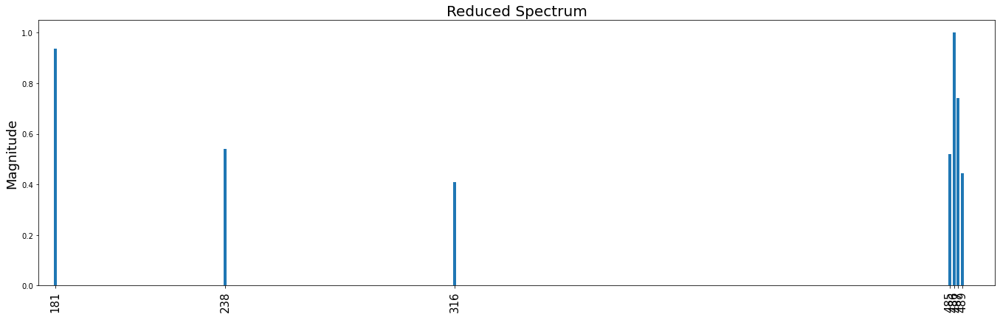

In [17]:
plot_peaks([f for f in freq_mag_dict_1.keys()], [m for m in freq_mag_dict_1.values()], plot_range=(175,500), width=1)

### Set 2:

In [18]:
freq_mag_dict_2 = {}
set_2 = pd.DataFrame(columns=['FREQUENCY (Hz)', 'AMPLITUDE'])
for freq, mag in zip(peak_freqs, peak_mags):
    if (mag > 0.42 and 160 < freq < 17000):
        freq_mag_dict_2[freq] = mag
        set_2 = set_2.append({'FREQUENCY (Hz)': freq, 'AMPLITUDE': mag}, ignore_index=True)
set_2

,FREQUENCY (Hz),AMPLITUDE
0,161.252024,0.742940
1,180.679978,0.936758
2,238.478144,0.541129
3,484.727469,0.520382
4,486.184566,1.000000
5,487.398813,0.742255
6,488.855909,0.443270


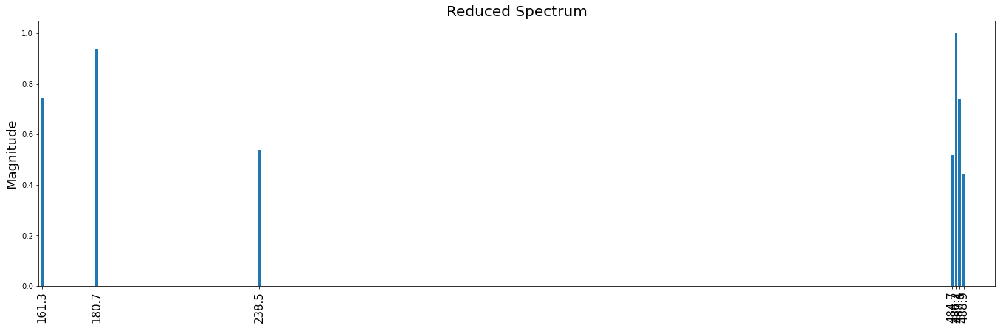

In [19]:
plot_peaks([f for f in freq_mag_dict_2.keys()], [m for m in freq_mag_dict_2.values()], plot_range=(160,500), width=1)

### Set 3:

In [20]:
freq_mag_dict_3 = {}
set_3 = pd.DataFrame(columns=['FREQUENCY (Hz)', 'AMPLITUDE'])
for freq, mag in zip(peak_freqs, peak_mags):
    if (160 < freq < 500 and mag > 0.8) or (650 < freq < 10000 and mag > 0.37):
        freq_mag_dict_3[freq] = mag
        set_3 = set_3.append({'FREQUENCY (Hz)': freq, 'AMPLITUDE': mag}, ignore_index=True)
set_3

,FREQUENCY (Hz),AMPLITUDE
0,180.679978,0.936758
1,486.184566,1.000000
2,1627.576902,0.388698
3,6133.162439,0.383222
4,8842.147868,0.400111


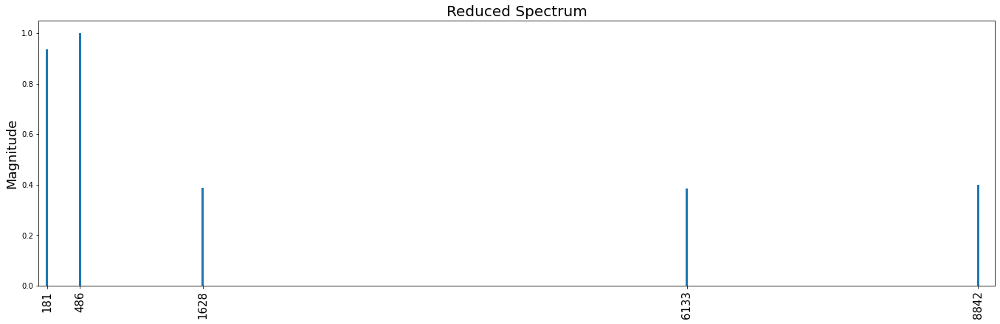

In [21]:
plot_peaks([f for f in freq_mag_dict_3.keys()], [m for m in freq_mag_dict_3.values()], plot_range=(100,9000), width=20)

#### We will next plot the dissonance curve for each set and see which has the most potential.

---

<h1> (4a) DRAW THE DISSONANCE CURVE

### Functions for finding the dissonance curve

The `dissonance_minima()` function calls the `measure_dissonance()` function for each interval and returns a list of ratios found at the minima of the dissonance curve.  If enabled, `plot_dissonance_curve()` will display a of the dissonance curve.

<b>NOTE:</b>  The functions `dissonance_minima()` and `measure_dissonance()` have been adapted from MATLAB code written by William A. Sethares (`dissmain.m` and `dissmeasure.m` found in the <i>TTSS</i> supplemental materials).  The basic algorithm remains intact but additional functionality has been added to make the code more "Pythonic".

In [22]:
def dissonance_minima(freq_mag_dict, inc=0.01, rng=2.3, show_plot=False):
    '''
    This main routine calls the function measure_dissonance()
    '''
    
    dissonance = np.array([0]);
    
    freq = np.fromiter(freq_mag_dict.keys(), dtype=float)
    amp = np.fromiter(freq_mag_dict.values(), dtype=float)
    
    # call function measure_dissonance for each interval
    for alpha in np.arange(1+inc, rng, inc):
        f = np.hstack((freq, alpha*freq))
        a = np.hstack((amp, amp))
        d = measure_dissonance(f, a)
        dissonance = np.hstack((dissonance, d))

    # normalize dissonance scores for output
    dissonance = np.interp(dissonance, (dissonance.min(), dissonance.max()), (0, 1)) # y-axis
        
    freq_ratios = np.arange(1, rng, inc) # x-axis
    
    # find minima
    diss_inv = dissonance*-1  
    minima = find_peaks(diss_inv, threshold=0.0001, distance=8.5)
    minima_ratios = freq_ratios[minima[0]]
    minima_diss_scores = (diss_inv[minima[0]])*-1    
    
    # manually inserting ratio 1.0 with score of 0.0 as this will always be true
    minima_ratios = np.insert(minima_ratios,0,1.0)
    minima_diss_scores = np.insert(minima_diss_scores,0,0.0)
        
    if show_plot:
        plot_dissonance_minima(freq_ratios, dissonance, minima_ratios, minima_diss_scores, rng)
    
    return {ratio:score for ratio,score in zip(minima_ratios, minima_diss_scores)}


In [23]:
def measure_dissonance(fvec, amp):
    '''
    given a pile of partials in fvec with amplitude amp,
    this routine calculates dissonance
    '''
    
    Dstar = 0.24; S1 = 0.0207; S2 = 18.96; C1 = 5; C2 = -5;
    A1 = -3.51; A2 = -5.75; first_pass = 1;
    N = fvec.size
    fvec, ind = np.sort(fvec), np.argsort(fvec) 
    ams = np.array(amp[ind])
    D = 0
    for i in range(1, N):
        Fmin = fvec[:N-i+1]
        S = Dstar / (S1 * Fmin + S2)
        Fdif = fvec[i-1:N] - fvec[:N-i+1]
        a = np.minimum(ams[i-1:N], ams[:N-i+1])
        Dnew = a * (C1*np.exp(A1*S*Fdif) + C2*np.exp(A2*S*Fdif))
        D = D + Dnew @ np.ones(Dnew.size).conj().T
    return D

In [24]:
def plot_dissonance_minima(freq_ratios, dissonance, minima, scores, plt_rng):
    fig, ax = plt.subplots(figsize=(18,5))
    ax.plot(freq_ratios, dissonance)
    ax.scatter(minima, scores, color='r', s=50, marker='X', label='Minima')
    ax.legend()
    plt.title('Dissonance Curve on the Interval of 1.0 to {}'.format(plt_rng), fontsize=20)
    plt.xlabel('Frequency Ratio', fontsize=18)
    plt.ylabel('Sensory Dissonance', fontsize=18)
    plt.xticks(np.arange(1,plt_rng,0.2), fontsize=14)
#     plt.yticks([0,1], fontsize=14)
    return plt.show()

In [25]:
def display_minima_scores(minima_set: dict, sorted_by='ratio'):
    print('Found <{n}> Dissonance Minima:\n'.format(n=len(minima_set)))
    if sorted_by == 'ratio':
        for ratio, diss in minima_set.items():
            print('Frequency Ratio:  {}\nDissonance Value: {}\n'.format(round(ratio, 4), round(diss, 2)))
    else:
        for ratio, diss in sorted(minima_set.items(), key=lambda item: item[1]):
            print('Frequency Ratio:  {}\nDissonance Value: {}\n'.format(round(ratio, 4), round(diss, 2)))

### Dissonance curves for subsets of partials from the sound ranging from the unison to just a bit more than two octaves:

### Set 1:

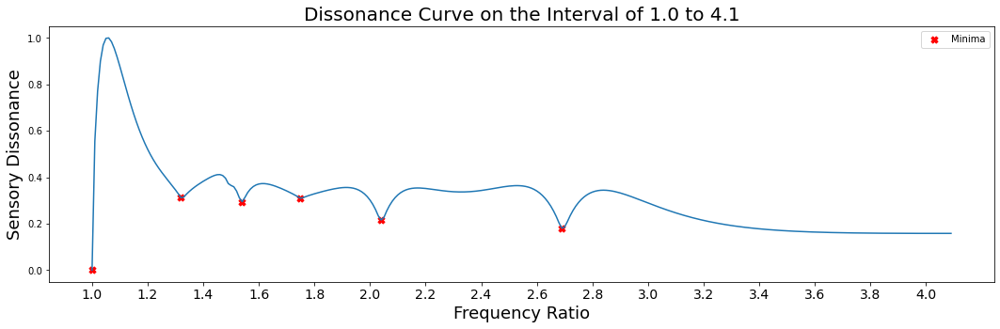

In [26]:
minima_set_1 = dissonance_minima(freq_mag_dict_1, rng=4.1, show_plot=True)

In [27]:
display_minima_scores(minima_set_1)

Found <6> Dissonance Minima:

Frequency Ratio:  1.0
Dissonance Value: 0.0

Frequency Ratio:  1.32
Dissonance Value: 0.31

Frequency Ratio:  1.54
Dissonance Value: 0.29

Frequency Ratio:  1.75
Dissonance Value: 0.31

Frequency Ratio:  2.04
Dissonance Value: 0.22

Frequency Ratio:  2.69
Dissonance Value: 0.18



### Set 2:

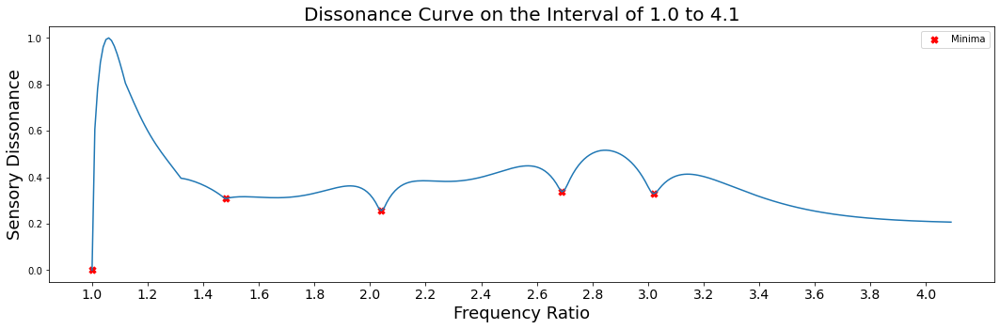

In [28]:
minima_set_2 = dissonance_minima(freq_mag_dict_2, rng=4.1, show_plot=True)

In [29]:
display_minima_scores(minima_set_2)

Found <5> Dissonance Minima:

Frequency Ratio:  1.0
Dissonance Value: 0.0

Frequency Ratio:  1.48
Dissonance Value: 0.31

Frequency Ratio:  2.04
Dissonance Value: 0.26

Frequency Ratio:  2.69
Dissonance Value: 0.34

Frequency Ratio:  3.02
Dissonance Value: 0.33



### Set 3:

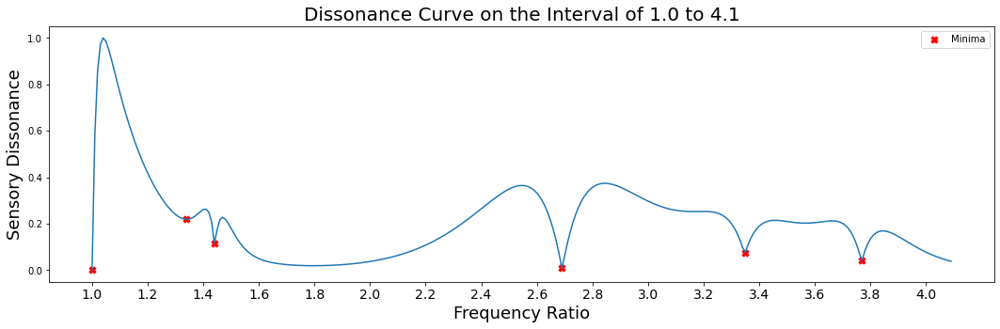

In [30]:
minima_set_3 = dissonance_minima(freq_mag_dict_3, rng=4.1, show_plot=True)

In [31]:
display_minima_scores(minima_set_3)

Found <6> Dissonance Minima:

Frequency Ratio:  1.0
Dissonance Value: 0.0

Frequency Ratio:  1.34
Dissonance Value: 0.22

Frequency Ratio:  1.44
Dissonance Value: 0.12

Frequency Ratio:  2.69
Dissonance Value: 0.01

Frequency Ratio:  3.35
Dissonance Value: 0.08

Frequency Ratio:  3.77
Dissonance Value: 0.04



#### Set 3 looks to be the most promising as it has the most pronounced minima with the lowest dissonance values. Let's revise its criteria by increasing the range of included frequencies...

In [32]:
freq_mag_dict_3_rev = {}
set_3_rev = pd.DataFrame(columns=['FREQUENCY (Hz)', 'AMPLITUDE'])
for freq, mag in zip(peak_freqs, peak_mags):
    if (160 < freq < 500 and mag > 0.8) or (650 < freq < 16500 and mag > 0.37):
        freq_mag_dict_3_rev[freq] = mag
        set_3_rev = set_3_rev.append({'FREQUENCY (Hz)': freq, 'AMPLITUDE': mag}, ignore_index=True)
set_3_rev

,FREQUENCY (Hz),AMPLITUDE
0,180.679978,0.936758
1,486.184566,1.000000
2,1627.576902,0.388698
3,6133.162439,0.383222
4,8842.147868,0.400111
5,13208.094981,0.400111
6,15917.080410,0.383222


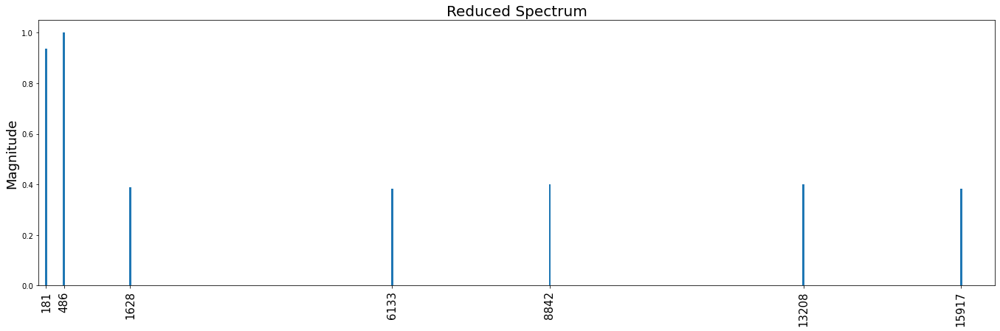

In [33]:
plot_peaks([f for f in freq_mag_dict_3_rev.keys()], [m for m in freq_mag_dict_3_rev.values()], plot_range=(50,16500), width=35)

### Set 3 (Revised):

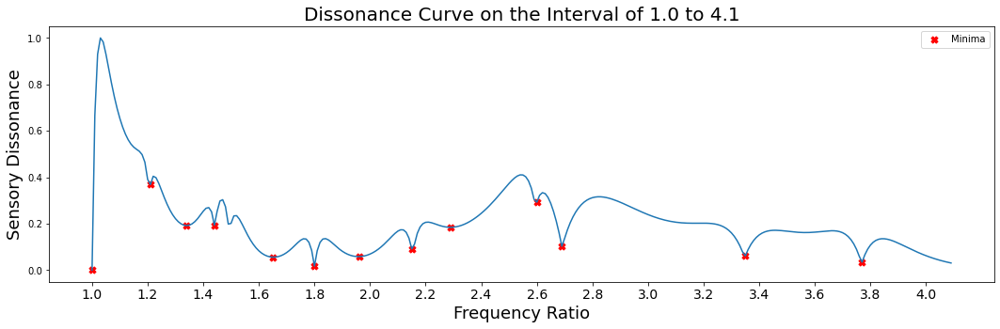

In [34]:
minima_set_3_rev = dissonance_minima(freq_mag_dict_3_rev, rng=4.1, show_plot=True)

#### If we double the frequency range of analysis, additional minima occur.

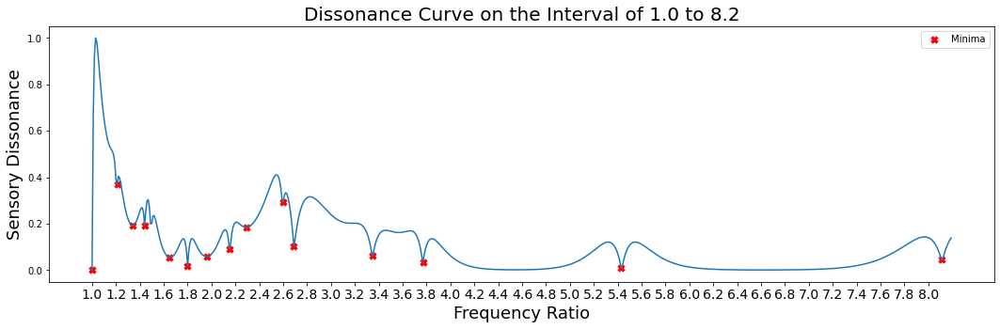

In [35]:
minima_set_3_rev = dissonance_minima(freq_mag_dict_3_rev, rng=8.2, show_plot=True)

#### These ratios found in the higher octaves may be useful when constructing a scale so we will include them in our minima set.

In [36]:
display_minima_scores(minima_set_3_rev)

Found <15> Dissonance Minima:

Frequency Ratio:  1.0
Dissonance Value: 0.0

Frequency Ratio:  1.21
Dissonance Value: 0.37

Frequency Ratio:  1.34
Dissonance Value: 0.19

Frequency Ratio:  1.44
Dissonance Value: 0.19

Frequency Ratio:  1.65
Dissonance Value: 0.06

Frequency Ratio:  1.8
Dissonance Value: 0.02

Frequency Ratio:  1.96
Dissonance Value: 0.06

Frequency Ratio:  2.15
Dissonance Value: 0.09

Frequency Ratio:  2.29
Dissonance Value: 0.18

Frequency Ratio:  2.6
Dissonance Value: 0.29

Frequency Ratio:  2.69
Dissonance Value: 0.1

Frequency Ratio:  3.35
Dissonance Value: 0.06

Frequency Ratio:  3.77
Dissonance Value: 0.03

Frequency Ratio:  5.43
Dissonance Value: 0.01

Frequency Ratio:  8.11
Dissonance Value: 0.05



---

<h1> (4b) CHOOSE A SET OF INTERVALS (A SCALE) FROM THE MINIMA

#### Before selecting intervals for a spectrum-scale can begin, it's important to understand the some key features of the spectrum's construction.

In [37]:
def find_nearest(value, search_list):
    '''
    Given a value and a list, finds the value in the list closest to the value.
    Returns the found value, its index in the list, and the difference between
    the search value and the found value.
    '''
    index = min(range(len(search_list)), key=lambda i: abs(search_list[i]-value))
    difference = value - search_list[index]
    return search_list[index], index, difference

In [38]:
def check_pseudo_oct(pseudo_octave, ratio, ratio_list, display_results=True):
    '''
    Given a pseudo-octave ratio, a ratio, and a list of ratios, checks how close
    the pseudo-octave approximates other ratios in the list by dividing the argument
    ratio by the pseudo-octave ratio.  Returns the closest value in the list and the
    difference between the target value and the found value.
    '''
    pseudo_octave_ratio = round(ratio / pseudo_octave, 4)
    found, _, difference = find_nearest(pseudo_octave_ratio, ratio_list)
    if display_results:
        print('Target ratio: {}/{}'.format(ratio, pseudo_octave))
        print('           => {}'.format(round(pseudo_octave_ratio, 2)))
        print('       Found: {}'.format(found))
        print('  Difference: {}'.format(round(difference, 2)))
#         print('\n')
    return found, difference

In [39]:
def calc_pseudo_oct_score(pseudo_octave: float, minima_dict: dict, display_results=True):
    '''
    Calculates how well a potential pseudo-octave ratio approximates ratios below it by 
    dividing ratios above it.
    '''
    minima_dict = {round(ratio, 4): score for ratio, score in minima_dict.items()}
    ratio_list = np.array([ratio for ratio in minima_dict.keys()])
    difference_score = 0
    matches = {ratio: 0 for ratio, diss in minima_dict.items()}
    for ratio in ratio_list[np.where(ratio_list > pseudo_octave)]:
        found, diff = check_pseudo_oct(pseudo_octave, ratio, ratio_list, display_results=display_results)
        matches[found] += 1
        difference_score += abs(diff)
        if display_results:
            print()
    # scale difference score by the target ratio's dissonance value
    difference_score *= minima_dict[pseudo_octave]
    if display_results:
        print('Weighted Sum Distance Score: {}'.format(round(difference_score, 4)))
    return difference_score, matches

### Determining the pseudo-octave

A ubiquitous feature of musical scales is that the intervals the compprise the scale repeat.  Commonly, this occurs at the ratio of 2:1, the octave, but there is a multitude of scales that repeat their intervallic cycle at an interval other than the perfect octave.  A famous non-octavating scale is the Bohlen–Pierce scale/tuning which repeats at the ratio 3:1, known as the Just Twelfth or "tritave".  Composer Iannis Xenakis used his own "Sieve Theory" to generate massive scales that would not repeat until several octaves.

Many sounds are not composed of partials in harmonic ratios.  Complex bell spectra, for instance, are almost entirely inharmonic and, thus, typically do not contain perfect 2:1 octave ratios in their spectrum.  That is not to say that intervallic patterns do not repeat or that the relationships between partials are completely random.  Inharmonic spectra, like most non-octavating scales, often begin to repeat at an interval that *functions* like an octave but not necessarily occuring at the 2:1 perfect octave ratio.  This octave-functioning interval is called the "pseudo-octave" and is a useful marker for constructing new scales and tunings.

#### Looking at the above dissonance curve, intuitively it would seem the ratio of 1.8 could be a good candidate for the pseudo-octave because it occurs close to the conventional 2/1 "true octave" ratio and because it has a considerably low dissonance value.  We can test if this, or any ratio, has "octavating qualities" by dividing any higher interval by it and measuring how close it reproduces intervals already found in the spectrum below.  Similarly, lower intervals when multiplied by the ratio of the pseudo-octave should closely match intervals found in the spectrum above.

#### A sanity check...

In [40]:
pseudo_octave = 1.8
test_ratio = 1.8

In [41]:
_, _ = check_pseudo_oct(pseudo_octave, test_ratio, [round(ratio, 4) for ratio in minima_set_3_rev.keys()])

Target ratio: 1.8/1.8
           => 1.0
       Found: 1.0
  Difference: 0.0


#### Now, let's check some other intervals above the pseudo-octave and see how close they approximate intervals lower in the spectrum...

In [42]:
print('Testing <{}> as potential pseudo-octave...\n'.format(pseudo_octave))
_, _ = calc_pseudo_oct_score(pseudo_octave, minima_set_3_rev, display_results=True)

Testing <1.8> as potential pseudo-octave...

Target ratio: 1.96/1.8
           => 1.09
       Found: 1.0
  Difference: 0.09

Target ratio: 2.15/1.8
           => 1.19
       Found: 1.21
  Difference: -0.02

Target ratio: 2.29/1.8
           => 1.27
       Found: 1.21
  Difference: 0.06

Target ratio: 2.6/1.8
           => 1.44
       Found: 1.44
  Difference: 0.0

Target ratio: 2.69/1.8
           => 1.49
       Found: 1.44
  Difference: 0.05

Target ratio: 3.35/1.8
           => 1.86
       Found: 1.8
  Difference: 0.06

Target ratio: 3.77/1.8
           => 2.09
       Found: 2.15
  Difference: -0.06

Target ratio: 5.43/1.8
           => 3.02
       Found: 2.69
  Difference: 0.33

Target ratio: 8.11/1.8
           => 4.51
       Found: 3.77
  Difference: 0.74

Weighted Sum Distance Score: 0.025


#### The ratio of 1.8 does, indeed, seem like a good choice for the pseudo-octave but there are some other ratios that may also work.  To be sure, we can test each potential pseudo-octave and compare their sum weighted difference scores.  

These scores consist of the sum of all the distances (the absolute value of the difference) between the target ratio and the closest ratio found in the reduced spectrum.  Because this approach biases the algorithm toward higher ratios (since there are more ratios below them to potentially match with) the sum distance is scaled by the dissonance value of whichever ratio is being tested as a pseudo-octave.  This ensures that ratios with lower dissonance values are prioritized whereas ratios with higher dissonance values are weighed with a heavier score.

In [43]:
diff_score_results = {}
match_results = {}
for ratio in (1.8, 1.96, 2.15, 2.29, 2.6, 2.69):
    diff_score_results[ratio], matches = calc_pseudo_oct_score(ratio, minima_set_3_rev, display_results=False)
    for match, hits in matches.items():
        if match in match_results:
            match_results[match] += hits
        else:
            match_results[match] = hits

for ratio, score in diff_score_results.items():
    print('Potential Pseudo-Octave Ratio: {}\nWeighted Sum Distance Score: {}\n'.format(ratio, round(score, 4)))

print('\nRatio with minimum Weighted Sum Distance Score: ', (min(diff_score_results, key=diff_score_results.get)))

Potential Pseudo-Octave Ratio: 1.8
Weighted Sum Distance Score: 0.025

Potential Pseudo-Octave Ratio: 1.96
Weighted Sum Distance Score: 0.0426

Potential Pseudo-Octave Ratio: 2.15
Weighted Sum Distance Score: 0.0296

Potential Pseudo-Octave Ratio: 2.29
Weighted Sum Distance Score: 0.0756

Potential Pseudo-Octave Ratio: 2.6
Weighted Sum Distance Score: 0.1138

Potential Pseudo-Octave Ratio: 2.69
Weighted Sum Distance Score: 0.0472


Ratio with minimum Weighted Sum Distance Score:  1.8


### Other interesting results

#### The intuitive choice appears to be vindicated.  Though the 1.8 ratio has the lowest weighted sum distance score, there are other ratios (like 2.15, 1.96, and 2.69) that have similarly low scores.

In [44]:
print('Ratio matches after testing all potential pseudo-octaves:\n')
print('{:>12}   {:<12}'.format('FREQ. RATIOS', 'NO. OF MATCHES'))
for ratio, matches in match_results.items():
    print('{:>12}   {:<12}'.format(ratio, matches))

Ratio matches after testing all potential pseudo-octaves:

FREQ. RATIOS   NO. OF MATCHES
         1.0   4           
        1.21   8           
        1.34   3           
        1.44   5           
        1.65   3           
         1.8   2           
        1.96   2           
        2.15   2           
        2.29   1           
         2.6   1           
        2.69   3           
        3.35   2           
        3.77   3           
        5.43   0           
        8.11   0           


The ratios of 1.21 and 1.44 occur frequently when testing for a pseudo-octave.  Though they do not have octave-functionality, they do seem to have generative qualities.

#### Conducting an informal "by hand" test of multiplying these ratios with other ratios in the spectrum verifies this intuition by yielding intervals close to those found in the reduced spectrum:

In [45]:
def test(test):
    found, _, diff = find_nearest(test, [round(ratio, 4) for ratio in minima_set_3_rev.keys()])
    print('Test: {}\nFound: {}\nDifference: {}'.format(round(test,2), found, round(diff,3)))

In [46]:
test(1.21 * 1.34)
print()
test(1.44 * 1.34)

Test: 1.62
Found: 1.65
Difference: -0.029

Test: 1.93
Found: 1.96
Difference: -0.03


In [47]:
test(1.21 * 1.65)
print()
test(1.44 * 1.65)

Test: 2.0
Found: 1.96
Difference: 0.036

Test: 2.38
Found: 2.29
Difference: 0.086


In [48]:
test(1.21 * 1.8)
print()
test(1.44 * 1.8)

Test: 2.18
Found: 2.15
Difference: 0.028

Test: 2.59
Found: 2.6
Difference: -0.008


In [49]:
test(1.21 * 1.96)
print()
test(1.44 * 1.96)

Test: 2.37
Found: 2.29
Difference: 0.082

Test: 2.82
Found: 2.69
Difference: 0.132


In [50]:
test(1.21 * 2.15)
print()
test(1.44 * 2.15)

Test: 2.6
Found: 2.6
Difference: 0.001

Test: 3.1
Found: 3.35
Difference: -0.254


#### ...and so on.

### We now have enough information to form a scale.

#### Converting ratios into cent values can help with scale construction by making their proximity to more familiar dodecaphonic intervals more clear.

In [51]:
def rat2cent(ratio):
    return 1200/math.log10(2) * math.log10(ratio)

In [52]:
ratio_cents_dict = {}
print('Spectrum ratios in descending order of dissonance:\n')
print('{:<5}{:^7}{:^7}{:>5}'.format('INDEX','RATIO', 'CENTS', 'DISS'))
for i, (ratio, diss) in enumerate(sorted(minima_set_3_rev.items(), key=lambda item: item[1])):
    ratio = round(ratio,4)
    cents = round(rat2cent(ratio))
    ratio_cents_dict[ratio] = cents
    print('{:<5}{:^7}{:^7}{:>5}'.format(i, ratio, cents, round(diss,2)))

Spectrum ratios in descending order of dissonance:

INDEX RATIO  CENTS  DISS
0      1.0     0     0.0
1     5.43   2929   0.01
2      1.8   1018   0.02
3     3.77   2297   0.03
4     8.11   3624   0.05
5     1.65    867   0.06
6     1.96   1165   0.06
7     3.35   2093   0.06
8     2.15   1325   0.09
9     2.69   1713    0.1
10    2.29   1434   0.18
11    1.34    507   0.19
12    1.44    631   0.19
13     2.6   1654   0.29
14    1.21    330   0.37


#### Accounting for fold-over about the pseudo-octave

In [53]:
ratio_cents_dict_foldover = {}
print('Spectrum ratios in descending order of dissonance:\n')
print('{:<5}{:^7}{:^7}{:>5}'.format('INDEX','RATIO', 'CENTS', 'DISS'))
for i, (ratio, diss) in enumerate(sorted(minima_set_3_rev.items(), key=lambda item: item[1])):
    ratio = round(ratio,4)
    while ratio > 1.8:
        ratio /= 1.8
    cents = round(rat2cent(ratio))
    ratio_cents_dict_foldover[ratio] = cents
    print('{:<5}{:^7}{:^7}{:>5}'.format(i, round(ratio,2), cents, round(diss,2)))

Spectrum ratios in descending order of dissonance:

INDEX RATIO  CENTS  DISS
0      1.0     0     0.0
1     1.68    894   0.01
2      1.8   1018   0.02
3     1.16    262   0.03
4     1.39    571   0.05
5     1.65    867   0.06
6     1.09    147   0.06
7     1.03    58    0.06
8     1.19    308   0.09
9     1.49    696    0.1
10    1.27    417   0.18
11    1.34    507   0.19
12    1.44    631   0.19
13    1.44    637   0.29
14    1.21    330   0.37


**NOTE:** in cases where a pseudo-octave occurs within or very close to the Just Noticeable Difference, quantizing the pseudo-octave to a conventional 1200 cent octave can make some synthesizer implementations easier (though at the expense of a more "interesting" non-octavating scale). 

---

<h1> (5) CREATE AN INSTRUMENT

#### Max/MSP implementation of a single double-plate system using the <i>Modalys</i> library:

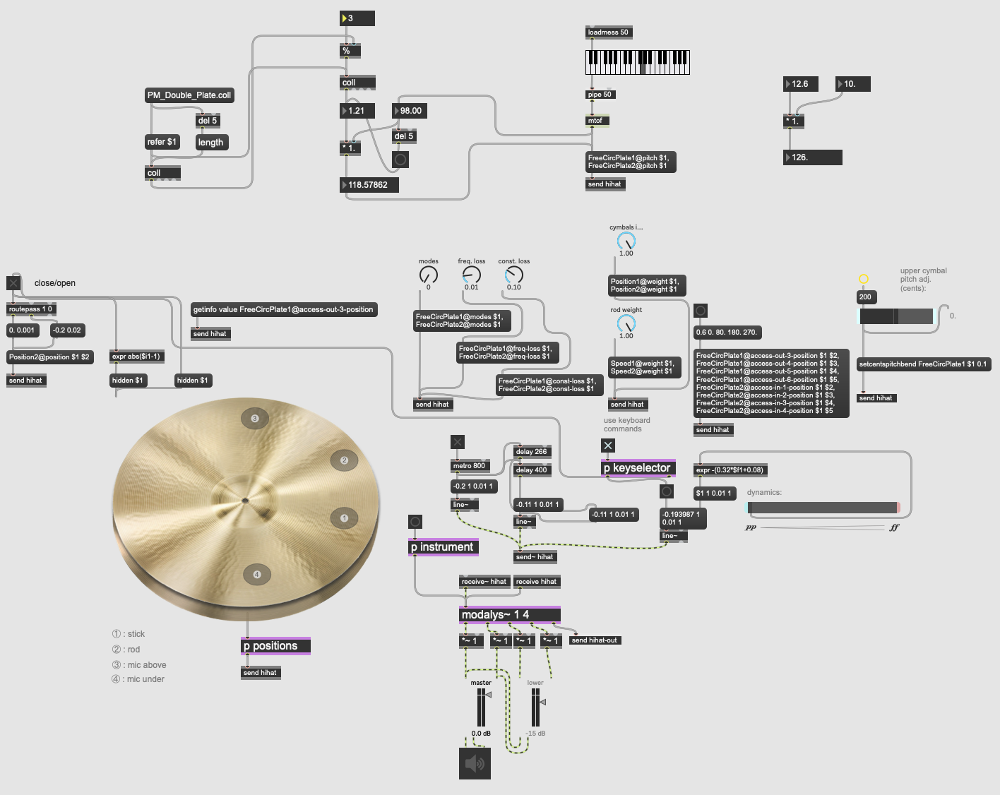

#### Inside the `instrument` subpatch where the actual physical modeling happens:

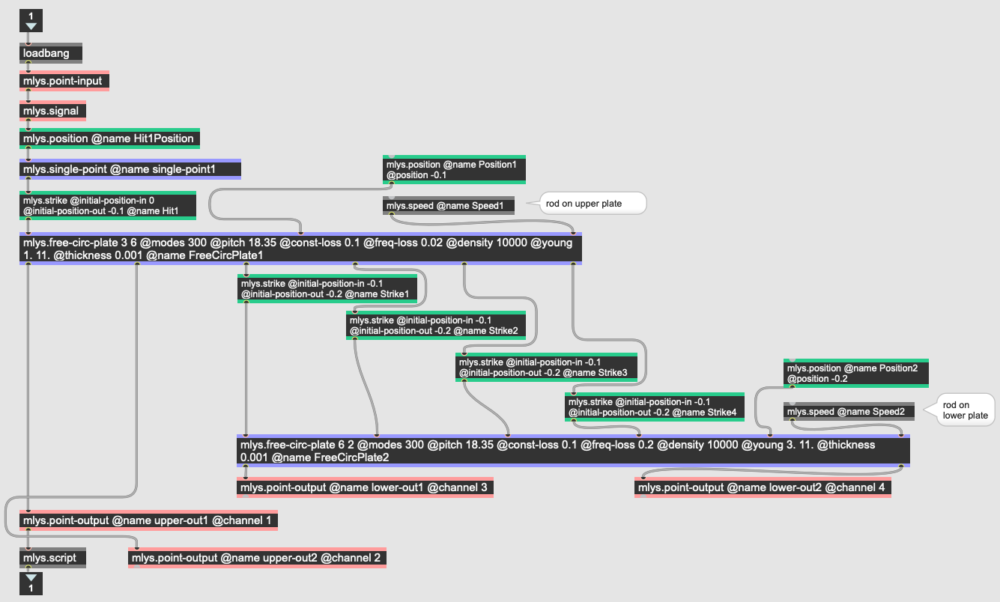

Note the `mlys.strike` object.  This specifies the type of impulse sent into the resonator (in this patch, the `mlys.free-circ-plate` objects).  Here we are using a conventional percussive "strike" impulse but it is also possible to simulate other impulses modes like plucks, bows, air jets, etc.

#### Write tuning file

In [54]:
def write_tuning(scale, name, description='\n', extension='.scl'):
    if extension == '.scl': # Scala format
        try:
            f = open(name + extension, 'w')
            f.write('! ' + name + '.scl\n!\n')
            f.write(description + '\n')
            f.write(' {steps}\n!\n'.format(steps = len(scale) - 1))
            for n in scale[1:]:
                f.write(str(n) + '\n')
            f.close()
            print('Tuning file \'{file}\' created!\n'.format(file = name + extension))
        except:
            print('Tuning file NOT created.\n')
    elif extension == '.tun': # Tun format
        print('.tun not yet supported.\n')
    elif extension == 'coll': # For 'coll' object in Max/MSP
        try:
            f = open(name + '.coll', 'w')
            for i, n in enumerate(scale):
                f.write('{}, {};\n'.format(i, n))
            f.close()
            print('Coll file \'{file}\' created!\n'.format(file = name + '.coll'))
        except:
            print('Tuning file NOT created.\n')

In [55]:
# Intuitively selected ratios from the ratio dictionary
scale_ratios = [1, 1.09, 1.16, 1.21, 1.39, 1.44, 1.65, 1.68, 1.8]
scale_cents = [round(rat2cent(ratio)) for ratio in scale_ratios]
name = 'PM_Double_Plate'
description = '9-note scale derived from the spectrum of a physically modeled metal plate (2021)'

In [56]:
# Scala format (for synths compatible with .scl files)
write_tuning(scale_cents, name, description, extension='.scl')

# Coll format (specifically for Max/MSP)
write_tuning(scale_ratios, name, extension='coll')

Tuning file 'PM_Double_Plate.scl' created!

Coll file 'PM_Double_Plate.coll' created!



---

<h1> (6) PLAY MUSIC

### A short demo of a physically modeled instrument composed of multiple suspended circular plates tuned to the above 9-note spectrum-scale:

#### Up and down the scale:

In [57]:
ipd.Audio('Audio/up_down_scale.wav')

#### Improvisation on scale:

In [58]:
ipd.Audio('Audio/improv.wav')

#### Because the sound is being synthesized on-the-fly, we can experiment with physical model parameters that would not be possible in the real world but can be simulated in the computer.  For instance, the same tuned metal plate instrument but with no audible attack—i.e. only the resultant resonance...

In [ ]:
ipd.Audio('Audio/res_only.wav')

---